In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from math import pi, inf
from sympy import limit
import time
from scipy.special import jv 
from itertools import product
import time
from scipy import real

In [3]:
# Parameters Barnes
ti_data = (1,2)


data1 = {"alpha" : 1/137, "c" : 1, "m1" : 1, "m2" : 1, "e1" : 1, "n1" : 1, "n2" : 1.65, "theta1" : 0, "theta2" : pi,  "w" : 1}
data1["delta"] = data1["alpha"]*data1["m1"]*data1["m2"]*(data1["theta1"] - data1["theta2"])/pi
data1["scale"] = (data1["w"]/(2*pi*data1["c"]))**(-1)
data1["e2"] = ti_data[0]
data1["m2"] = ti_data[1]
data1["k1"] = data1["n1"]*data1["w"]/data1["c"]
data1["k2"] = data1["n2"]*data1["w"]/data1["c"]
data1['n2'] = np.sqrt(data1['e2']*data1['m2'])

data2 = {"alpha" : 1/137, "c" : 1, "m1" : 1, "m2" : 1, "e1" : 1, "n1" : 1, "n2" : 1.65, "theta1" : 0, "theta2" : 100000*pi,  "w" : 1}
data2["delta"] = data2["alpha"]*data2["m1"]*data2["m2"]*(data2["theta1"] - data2["theta2"])/pi
data2["scale"] = 1
data2["e2"] = ti_data[0]
data2["m2"] = ti_data[1]
data2["k1"] = data2["n1"]*data2["w"]/data2["c"]
data2["k2"] = data2["n2"]*data2["w"]/data2["c"]
data2['n2'] = np.sqrt(data2['e2']*data2['m2'])

data3 = {"alpha" : 1/137, "c" : 1, "m1" : 1, "m2" : 1, "e1" : 1, "n1" : 1, "n2" : 1.65, "theta1" : 0, "theta2" : 0,  "w" : 1}
data3["delta"] = data3["alpha"]*data3["m1"]*data3["m2"]*(data3["theta1"] - data3["theta2"])/pi
data3["scale"] = (data3["w"]/(2*pi*data3["c"]))**(-1)
data3["e2"] = ti_data[0]
data3["m2"] = ti_data[1]
data3["k1"] = data3["n1"]*data3["w"]/data3["c"]
data3["k2"] = data3["n2"]*data3["w"]/data3["c"]
data3['n2'] = np.sqrt(data3['e2']*data3['m2'])


data_lifetime = {"alpha" : 1/137, "c" : 299792458, "m1" : 1, "m2" : 1, "e1" : 1, "n1" : 1, "n2" : 1.65, "theta1" : 0, "theta2" : pi,  "w" : 1}
# data_lifetime['m2'] = data_lifetime['m1']*(np.sqrt(0.48**2+17.3**2)*4*pi*10**(-7) + 1)
data_lifetime['alpha'] = 1/137
data_lifetime['m2'] = np.sqrt(0.48**2+17.1**2)*4*pi*10**(-7)
data_lifetime["e2"] = (data_lifetime['n2']**2)/data_lifetime['m2']
data_lifetime['w'] = 2*pi*data_lifetime['c']/(600*10**(-9))
data_lifetime["delta"] = data_lifetime["alpha"]*data_lifetime["m1"]*data_lifetime["m2"]*(data_lifetime["theta1"] - data_lifetime["theta2"])/pi
data_lifetime["scale"] = (data_lifetime["w"]/(2*pi*data_lifetime["c"]))**(-1)
data_lifetime["k1"] = data_lifetime["n1"]*data_lifetime["w"]/data_lifetime["c"]
data_lifetime["k2"] = data_lifetime["n2"]*data_lifetime["w"]/data_lifetime["c"]


In [4]:
def Rtmtm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c, **kwargs): 
    thingy = ( (e2*np.sqrt(k1**2-kp**2)-e1*np.sqrt(k2**2-kp**2) )*(m1*m2*(m2*np.sqrt(k1**2-kp**2)+m1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)/( (e2*np.sqrt(k1**2-kp**2) + e1*np.sqrt(k2**2-kp**2) )*(m1*m2*(m2*np.sqrt(k1**2-kp**2)+m1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
    return thingy

def Rtetm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c, **kwargs):
    thingy = -2*m2*n1*np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta/( (e2*np.sqrt(k1**2-kp**2) + e1*np.sqrt(k2**2-kp**2) )*(m1*m2*(m2*np.sqrt(k1**2-kp**2)+m1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
    return thingy

def Rtete(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c, **kwargs):
    thingy = ( (m2*np.sqrt(k1**2-kp**2)-m1*np.sqrt(k2**2-kp**2) )*(m1*m2*(e2*np.sqrt(k1**2-kp**2)+e1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)/( (m2*np.sqrt(k1**2-kp**2) + m1*np.sqrt(k2**2-kp**2) )*(m1*m2*(e2*np.sqrt(k1**2-kp**2)+e1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
    return thingy

def Rtmte(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c, **kwargs):
    thingy = -2*m2*n1*np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta/( (m2*np.sqrt(k1**2-kp**2) + m1*np.sqrt(k2**2-kp**2) )*(m1*m2*(e2*np.sqrt(k1**2-kp**2)+e1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
    return thingy

def Ttmtm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c, **kwargs):
    thingy = n2/n1 * (2*e1*np.sqrt(k1**2-kp**2))*(m1*m2*(m2*np.sqrt(k1**2-kp**2)+m1*np.sqrt(k2**2-kp**2)))/ ( (e2*np.sqrt(k1**2-kp**2) + e1*np.sqrt(k2**2-kp**2) )*(m1*m2*(m2*np.sqrt(k1**2-kp**2)+m1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
    return thingy
    
def Ttetm(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c, **kwargs):
    thingy = -2*m2*n1*np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta/( (m2*np.sqrt(k1**2-kp**2) + m1*np.sqrt(k2**2-kp**2) )*(m1*m2*(e2*np.sqrt(k1**2-kp**2)+e1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
    return thingy

def Ttmte(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c, **kwargs):
    thingy = 2*m2*n2*np.sqrt(k1**2-kp**2)**2*delta/( (m2*np.sqrt(k1**2-kp**2) + m1*np.sqrt(k2**2-kp**2) )*(m1*m2*(e2*np.sqrt(k1**2-kp**2)+e1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
    return thingy

def Ttete(kp, e1, e2, k1, k2, m1, m2, n1, n2, delta, c, **kwargs):
    thingy = 2*m2*np.sqrt(k1**2-kp**2)*(m1*m2*(e2*np.sqrt(k1**2-kp**2)+e1*np.sqrt(k2**2-kp**2)))/( (m2*np.sqrt(k1**2-kp**2) + m1*np.sqrt(k2**2-kp**2) )*(m1*m2*(e2*np.sqrt(k1**2-kp**2)+e1*np.sqrt(k2**2-kp**2))) + np.sqrt(k1**2-kp**2)*np.sqrt(k2**2-kp**2)*delta**2)
    return thingy

In [5]:
def GRzz_integrand(kp, x, y, z, zp, data=data1):
    k1 = data["k1"]
    return np.imag((1j/(4*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*jv(0,kp*np.sqrt(x**2+y**2))*(kp**3/(k1**2*np.sqrt(k1**2-kp**2)))*Rtmtm(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"]))

def GRyz_integrand(kp, x, y, z, zp, data=data1):
    k1 = data["k1"]
    return np.imag((1/(4*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*jv(1,kp*np.sqrt(x**2+y**2))*(kp**2/(k1*np.sqrt(k1**2-kp**2)))*Rtetm(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"]))

def GRxz_integrand(kp, x, y, z, zp, data=data1):
    k1 = data["k1"]
    return np.imag((1/(4*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*jv(1,kp*np.sqrt(x**2+y**2))*(kp**2/k1)*Rtmtm(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"]))

def GRxx_integrand(kp, x, y, z, zp, data=data1):
    rtmtm = Rtmtm(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"])
    rtete = Rtete(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"])
    k1 = data["k1"]
    return np.imag((1j/(8*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*((jv(0,kp*np.sqrt(x**2+y**2)) + jv(2,kp*np.sqrt(x**2+y**2)))*(kp/(np.sqrt(k1**2-kp**2)))*rtete - (jv(0,kp*np.sqrt(x**2+y**2)) - jv(2,kp*np.sqrt(x**2+y**2)))*(kp*np.sqrt(k1**2-kp**2)/k1**2)*rtmtm))

def GRyx_integrand(kp, x, y, z, zp, data=data1):
    rtetm = Rtetm(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"])
    rtmte = Rtmte(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"])
    k1 = data["k1"]
    return np.imag((-1j/(8*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*((jv(0,kp*np.sqrt(x**2+y**2)) - jv(2,kp*np.sqrt(x**2+y**2)))*(kp/k1)*rtetm + (jv(0,kp*np.sqrt(x**2+y**2)) + jv(2,kp*np.sqrt(x**2+y**2)))*(kp/k1)*rtmte))

def GRzx_integrand(kp, x, y, z, zp, data=data1):
    rtmtm = Rtmtm(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"])
    k1 = data["k1"]
    return np.imag((-1/(4*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*jv(1,kp*np.sqrt(x**2+y**2))*(kp**2/k1**2)*rtmtm)

def GRyy_integrand(kp, x, y, z, zp, data=data1):
    rtmtm = Rtmtm(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"])
    rtete = Rtete(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"])
    k1 = data["k1"]
    return np.imag((1j/(8*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*((jv(0,kp*np.sqrt(x**2+y**2)) - jv(2,kp*np.sqrt(x**2+y**2)))*(kp/(np.sqrt(k1**2-kp**2)))*rtete - (jv(0,kp*np.sqrt(x**2+y**2)) + jv(2,kp*np.sqrt(x**2+y**2)))*(kp*np.sqrt(k1**2-kp**2)/k1**2)*rtmtm))

def GRxy_integrand(kp, x, y, z, zp, data=data1):
    rtetm = Rtetm(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"])
    rtmte = Rtmte(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"])
    k1 = data["k1"]
    return np.imag((1j/(8*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*((jv(0,kp*np.sqrt(x**2+y**2)) + jv(2,kp*np.sqrt(x**2+y**2)))*(kp/k1)*rtetm + (jv(0,kp*np.sqrt(x**2+y**2)) - jv(2,kp*np.sqrt(x**2+y**2)))*(kp/k1)*rtmte))

def GRzy_integrand(kp, x, y, z, zp, data=data1):
    rtmte = Rtmte(kp, data["e1"], data["e2"], data["k1"], data["k2"], data["m1"], data["m2"], data["n1"], data["n2"], data["delta"], data["c"])
    k1 = data["k1"]
    return np.imag((1/(4*pi))*(np.e**(1j*np.sqrt(k1**2-kp**2)*(z + zp)))*jv(1,kp*np.sqrt(x**2+y**2))*(kp**2/(k1*np.sqrt(k1**2-kp**2)))*rtmte)


In [6]:
def G_xz(x, y, z, zp=1.5, data=data1):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRxz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_yz(x, y, z, zp=1.5, data=data1):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRyz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_zz(x, y, z, zp=1.5, data=data1):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRzz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_xx(x, y, z, zp=1.5, data=data1):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRxx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_yx(x, y, z, zp=1.5, data=data1):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRyx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_zx(x, y, z, zp=1.5, data=data1):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRzx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_xy(x, y, z, zp=1.5, data=data1):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRxy_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_yy(x, y, z, zp=1.5, data=data1):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRyy_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

def G_zy(x, y, z, zp=1.5, data=data1):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    return quad(GRzy_integrand, 0, 1, args=(x,y,z,zp,data,))[0]

In [7]:
Gzz = np.vectorize(G_zz)
Gyz = np.vectorize(G_yz)
Gxz = np.vectorize(G_xz)
Gxx = np.vectorize(G_xx)
Gyx = np.vectorize(G_yx)
Gzx = np.vectorize(G_zx)
Gxy = np.vectorize(G_xy)
Gyy = np.vectorize(G_yy)
Gzy = np.vectorize(G_zy)

In [8]:
start = time.time()

x = np.arange(-2,2, 0.04)
y = [0]*len(x)
z = np.arange(0,3, 0.03)

x,z = np.meshgrid(x,z)

end = time.time()
print('elapsed time xyz product: {} seg'.format(end - start))

elapsed time xyz product: 0.0010001659393310547 seg


In [9]:
start = time.time()
Gzz_points1 = Gzz(x,0,z, data=data1)
Gzz_points2 = Gzz(x,0,z, data=data3)
end = time.time()
print('** elapsed time for Gzz calculations: {} seg'.format(end - start))

start = time.time()
Gyz_points1 = Gyz(x,0,z, data=data1)
Gyz_points2 = Gyz(x,0,z, data=data3)
end = time.time()
print('** elapsed time for Gyz calculations: {} seg'.format(end - start))

start = time.time()
Gxz_points1 = Gxz(x,0,z, data=data1)
Gxz_points2 = Gxz(x,0,z, data=data3)
end = time.time()
print('** elapsed time for Gxz calculations: {} seg'.format(end - start))

start = time.time()
Gxx_points1 = Gxx(x,0,z, data=data1)
Gxx_points2 = Gxx(x,0,z, data=data3)
end = time.time()
print('** elapsed time for Gxx calculations: {} seg'.format(end - start))

start = time.time()
Gyx_points1 = Gyx(x,0,z, data=data1)
Gyx_points2 = Gyx(x,0,z, data=data3)
end = time.time()
print('** elapsed time for Gyx calculations: {} seg'.format(end - start))

start = time.time()
Gzx_points1 = Gzx(x,0,z, data=data1)
Gzx_points2 = Gzx(x,0,z, data=data3)
end = time.time()
print('** elapsed time for Gzx calculations: {} seg'.format(end - start))

<ipython-input-6-9518f24a5ab4>:11: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRzz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]


** elapsed time for Gzz calculations: 182.1538209915161 seg


<ipython-input-6-9518f24a5ab4>:7: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRyz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]


** elapsed time for Gyz calculations: 44.111287355422974 seg


<ipython-input-6-9518f24a5ab4>:3: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRxz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]


** elapsed time for Gxz calculations: 103.47020959854126 seg


<ipython-input-6-9518f24a5ab4>:15: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRxx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]


** elapsed time for Gxx calculations: 361.80432987213135 seg
** elapsed time for Gyx calculations: 90.77019262313843 seg


<ipython-input-6-9518f24a5ab4>:23: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRzx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]


** elapsed time for Gzx calculations: 106.43491458892822 seg


In [10]:
start = time.time()
Gxy_points1 = Gxy(x,0,z, data=data1)
Gxy_points2 = Gxy(x,0,z, data=data3)
end = time.time()
print('** elapsed time for Gxy calculations: {} seg'.format(end - start))

start = time.time()
Gyy_points1 = Gyy(x,0,z, data=data1)
Gyy_points2 = Gyy(x,0,z, data=data3)
end = time.time()
print('** elapsed time for Gyy calculations: {} seg'.format(end - start))

start = time.time()
Gzy_points1 = Gzy(x,0,z, data=data1)
Gzy_points2 = Gzy(x,0,z, data=data3)
end = time.time()
print('** elapsed time for Gzy calculations: {} seg'.format(end - start))

KeyboardInterrupt: 

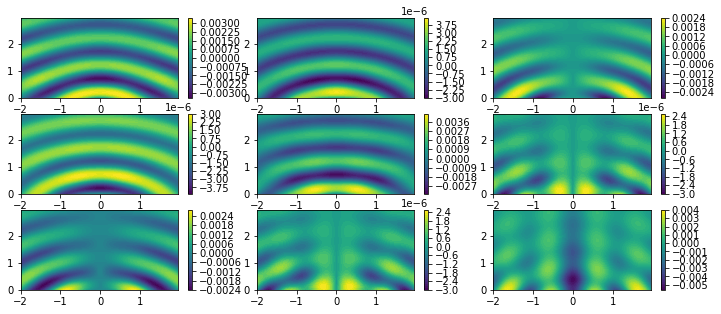

In [11]:
fig, axs = plt.subplots(3, 3, figsize=(12,5))
cs00 = axs[0,0].contourf(x, z, Gxx_points1, 50)
cs01 = axs[0,1].contourf(x, z, Gyx_points1, 50)
cs02 = axs[0,2].contourf(x, z, Gzx_points1, 50)
cs10 = axs[1,0].contourf(x, z, Gxy_points1, 50)
cs11 = axs[1,1].contourf(x, z, Gyy_points1, 50)
cs12 = axs[1,2].contourf(x, z, Gzy_points1, 50)
cs20 = axs[2,0].contourf(x, z, Gxz_points1, 50)
cs21 = axs[2,1].contourf(x, z, Gyz_points1, 50)
cs22 = axs[2,2].contourf(x, z, Gzz_points1, 50)

fig.colorbar(cs00, ax=axs[0,0])
fig.colorbar(cs01, ax=axs[0,1])
fig.colorbar(cs02, ax=axs[0,2])
fig.colorbar(cs10, ax=axs[1,0])
fig.colorbar(cs11, ax=axs[1,1])
fig.colorbar(cs12, ax=axs[1,2])
fig.colorbar(cs20, ax=axs[2,0])
fig.colorbar(cs21, ax=axs[2,1])
fig.colorbar(cs22, ax=axs[2,2])

In [11]:
# Emission Rate 
def rho_xz(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n1']**2/data['w'])*Gxz(x,y,z,z,data)

def rho_yz(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n1']**2/data['w'])*Gyz(x,y,z,z,data)

def rho_zz(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n1']**2/data['w'])*Gzz(x,y,z,z,data)

def rho_xx(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n1']**2/data['w'])*Gxx(x,y,z,z,data)

def rho_yx(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n1']**2/data['w'])*Gyx(x,y,z,z,data)

def rho_zx(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n1']**2/data['w'])*Gzx(x,y,z,z,data)

def rho_xy(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n1']**2/data['w'])*Gxy(x,y,z,z,data)

def rho_yy(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n1']**2/data['w'])*Gyy(x,y,z,z,data)

def rho_zy(x, y, z, data=data1):
    return 1 + (6*pi*data['c']*data['n1']**2/data['w'])*Gzy(x,y,z,z,data)

In [12]:
#LDOS y Lifetime 
def ldos(x, y, z, data=data1):
    return 1 + ((2*pi*data['c']*data['n1']**2)/(data['w']))*(Gxx(x,y,z,z,data=data)+Gyy(x,y,z,z,data=data)+Gzz(x,y,z,z,data=data))

def lifetime(x, y, z, data=data1, t_inf=1, eta=0.61):
    return t_inf/(1 + eta*(ldos(x, y, z, data=data) - 1))

In [13]:
zl = np.arange(0, 2, 0.01)

start = time.time()
lifetime_points1 = lifetime(0,0,zl, data=data1)
lifetime_points2 = lifetime(0,0,zl, data=data2)

end = time.time()
print('** elapsed time for lifetime calculations: {} seg'.format(end - start))

<ipython-input-6-9518f24a5ab4>:15: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRxx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:31: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRyy_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:11: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRzz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:15: IntegrationWarning: The algorithm does not converge.  Roundoff error is detected
  in the extrapolation table.  It is assumed that the requested tolerance
  cannot be achieved, and that the returned result (if full_output = 1) is 
  the best which can be obtained.
  return quad(GRxx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:31: IntegrationWarning: The algorithm does not converge.  Roundoff error is detect

** elapsed time for lifetime calculations: 24.71802306175232 seg


Text(0, 0.5, '$\\tau(z)/\\tau(\\infty)$')

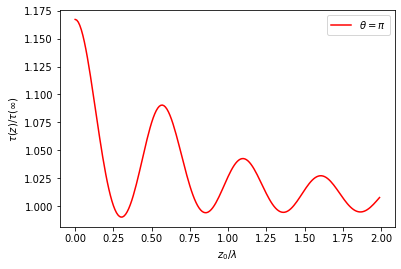

In [15]:
fig, ax = plt.subplots()
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels)

perp, = ax.plot(zl, lifetime_points1, label=r'$\theta=\pi$', color= 'red') 
# parall, = ax.plot(zl, lifetime_points2, label=r'$\theta>>\pi$', color= 'blue')

ax.legend(handles=[perp], prop={'size': 10})
ax.set_xlabel(r'$z_0/\lambda$')
ax.set_ylabel(r'$\tau(z)/\tau(\infty)$')


In [14]:
def pldos_perp(x, y, z, data=data1):
    return 1 + ((6*pi*data['c']*data['n1']**2)/(data['w']))*(Gzz(x,y,z,z,data))

def pldos_paral(x, y, z, data=data1):
    return 1 + ((3*pi*data['c']*data['n1']**2)/(data['w']))*(Gxx(x,y,z,z,data)+Gyy(x,y,z,z,data))

<ipython-input-6-9518f24a5ab4>:11: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRzz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:15: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRxx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:31: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRyy_integrand, 0, 1, args=(x,y,z,zp,data,))[0]


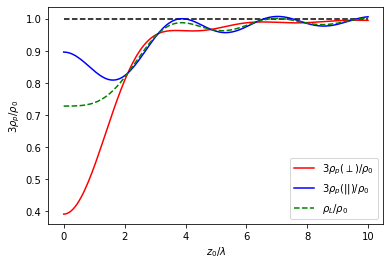

elapsed time: 14.267171859741211 seg


In [18]:
data = data3
prefix = 'notopo'

start = time.time()

x_max = 10/data1['scale']
x = np.arange(0,x_max, 0.01)
y_perp = pldos_perp(0, 0, x, data=data)
y_parall = pldos_paral(0, 0, x, data=data)
y_ldos = ldos(0, 0, x, data=data)

# %%
fig, ax = plt.subplots()
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels)

base_line, = ax.plot(x*data1['scale'], [1 for z in x], linestyle='--', color= 'black')
perp, = ax.plot(x*data1['scale'], y_perp, label=r'$3\rho_p(\perp)/\rho_0$', color= 'red') 
parall, = ax.plot(x*data1['scale'], y_parall, label=r'$3\rho_p(||)/\rho_0$', color= 'blue')
gldos, = ax.plot(x*data1['scale'], y_ldos, linestyle='--', label=r'$\rho_L/\rho_0$', color= 'green')

ax.legend(handles=[perp,parall, gldos], prop={'size': 10})
ax.set_xlabel(r'$z_0/\lambda$')
ax.set_ylabel(r'$3\rho_p/\rho_0$')
plt.show()
fig.savefig('plots_report/PLDOS_plot_mu={}_{}.png'.format(data1['m2'],prefix), bbox_inches='tight')

end = time.time()
print('elapsed time: {} seg'.format(end - start))


<ipython-input-6-9518f24a5ab4>:11: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRzz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:15: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRxx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:31: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRyy_integrand, 0, 1, args=(x,y,z,zp,data,))[0]


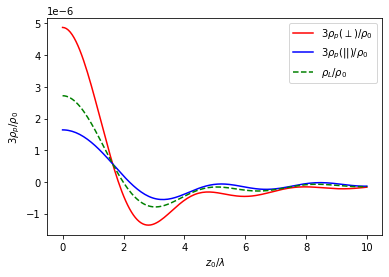

In [22]:
x_max = 10/data1['scale']
x = np.arange(0,x_max, 0.01)
y_perp1 = pldos_perp(0, 0, x, data=data1)
y_parall1 = pldos_paral(0, 0, x, data=data1)
y_ldos1 = ldos(0, 0, x, data=data1)

y_perp2 = pldos_perp(0, 0, x, data=data3)
y_parall2 = pldos_paral(0, 0, x, data=data3)
y_ldos2 = ldos(0, 0, x, data=data3)

y_perp = y_perp1 - y_perp2
y_parall = y_parall1 - y_parall2
y_ldos = y_ldos1 - y_ldos2

# %%
fig, ax = plt.subplots()
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels)

perp, = ax.plot(x*data1['scale'], y_perp, label=r'$3\rho_p(\perp)/\rho_0$', color= 'red') 
parall, = ax.plot(x*data1['scale'], y_parall, label=r'$3\rho_p(||)/\rho_0$', color= 'blue')
gldos, = ax.plot(x*data1['scale'], y_ldos, linestyle='--', label=r'$\rho_L/\rho_0$', color= 'green')

ax.legend(handles=[perp,parall, gldos], prop={'size': 10})
ax.set_xlabel(r'$z_0/\lambda$')
ax.set_ylabel(r'$3\rho_p/\rho_0$')
plt.show()
fig.savefig('plots_report/PLDOS_plot_mu={}_diff.png'.format(data1['m2']), bbox_inches='tight')


<ipython-input-6-9518f24a5ab4>:11: IntegrationWarning: The algorithm does not converge.  Roundoff error is detected
  in the extrapolation table.  It is assumed that the requested tolerance
  cannot be achieved, and that the returned result (if full_output = 1) is 
  the best which can be obtained.
  return quad(GRzz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:11: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRzz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:15: IntegrationWarning: The algorithm does not converge.  Roundoff error is detected
  in the extrapolation table.  It is assumed that the requested tolerance
  cannot be achieved, and that the returned result (if full_output = 1) is 
  the best which can be obtained.
  return quad(GRxx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:15: IntegrationWarning: The integral is probably divergent, or slowly 

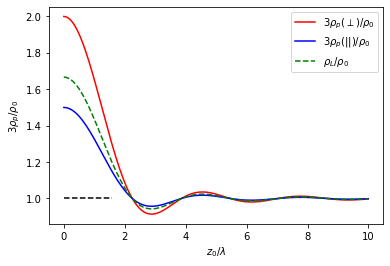

elapsed time: 35.81803512573242 seg


In [18]:
start = time.time()

x_max = 10/data2['scale']
x = np.arange(0,x_max, 0.01)
y_perp = pldos_perp(0, 0, x, data=data2)
y_parall = pldos_paral(0, 0, x, data=data2)
y_ldos = ldos(0, 0, x, data=data2)

# %%
fig, ax = plt.subplots()
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels)

base_line, = ax.plot(x, [1 for z in x], linestyle='--', color= 'black')
perp, = ax.plot(x*data1['scale'], y_perp, label=r'$3\rho_p(\perp)/\rho_0$', color= 'red') 
parall, = ax.plot(x*data1['scale'], y_parall, label=r'$3\rho_p(||)/\rho_0$', color= 'blue')
gldos, = ax.plot(x*data1['scale'], y_ldos, linestyle='--', label=r'$\rho_L/\rho_0$', color= 'green')

ax.legend(handles=[perp, parall, gldos], prop={'size': 10})
ax.set_xlabel(r'$z_0/\lambda$')
ax.set_ylabel(r'$3\rho_p/\rho_0$')
plt.show()

end = time.time()
print('elapsed time: {} seg'.format(end - start))

<ipython-input-6-9518f24a5ab4>:11: IntegrationWarning: The algorithm does not converge.  Roundoff error is detected
  in the extrapolation table.  It is assumed that the requested tolerance
  cannot be achieved, and that the returned result (if full_output = 1) is 
  the best which can be obtained.
  return quad(GRzz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:11: IntegrationWarning: The integral is probably divergent, or slowly convergent.
  return quad(GRzz_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:15: IntegrationWarning: The algorithm does not converge.  Roundoff error is detected
  in the extrapolation table.  It is assumed that the requested tolerance
  cannot be achieved, and that the returned result (if full_output = 1) is 
  the best which can be obtained.
  return quad(GRxx_integrand, 0, 1, args=(x,y,z,zp,data,))[0]
<ipython-input-6-9518f24a5ab4>:15: IntegrationWarning: The integral is probably divergent, or slowly 

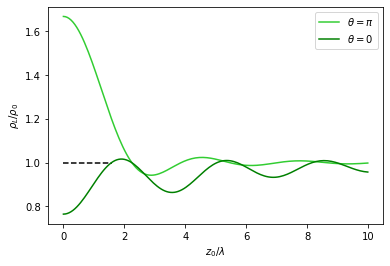

elapsed time: 49.51494574546814 seg


In [19]:
start = time.time()

x_max = 10/data2['scale']
x = np.arange(0,x_max, 0.01)
y_perp = pldos_perp(0, 0, x, data=data2)
y_parall = pldos_paral(0, 0, x, data=data2)
y_ldos = ldos(0, 0, x, data=data2)

y_perp3 = pldos_perp(0, 0, x, data=data3)
y_parall3 = pldos_paral(0, 0, x, data=data3)
y_ldos3 = ldos(0, 0, x, data=data3)

# %%
fig, ax = plt.subplots()
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels)

base_line, = ax.plot(x, [1 for z in x], linestyle='--', color= 'black')
parall, = ax.plot(x*data1['scale'], y_ldos, label=r'$\theta=\pi$', color= 'limegreen')
gldos, = ax.plot(x*data1['scale'], y_ldos3, label=r'$\theta=0$', color= 'green')

ax.legend(handles=[parall, gldos], prop={'size': 10})
ax.set_xlabel(r'$z_0/\lambda$')
ax.set_ylabel(r'$\rho_L/\rho_0$')
plt.show()

end = time.time()
print('elapsed time: {} seg'.format(end - start))

In [38]:
#G0
def G0(x,y,z,zp=1.5,xp=0,yp=0,data=data1):
    x,y,z,zp = x*data['scale'], y*data['scale'], z*data['scale'], zp*data['scale']
    w = data['w']
    k = data['k1']
    R = np.sqrt((x-xp)**2+(y-yp)**2+(z-zp)**2)
    Id = np.array([[1,0,0],[0,1,0],[0,0,1]])
    Rv = np.array([x-xp,y-yp,z-zp])
    thing = np.e**(1j*k*R)/(4*pi*R)*((1 + (1j*k*R-1)/(k**2*R**2))*Id+ (3-3j*k*R-k**2*R**2)/(k**2*R**4)*np.outer(Rv,Rv))
    return thing

def G0_xx(x,y,z,zp=1.5,data=data1):
    thing = np.imag(G0(x,y,z,zp=zp,data=data)[0,0])
    if abs(thing) >= 10: return 0
    return thing

def G0_yx(x,y,z,zp=1.5,data=data1):
    return np.imag(G0(x,y,z,zp=zp,data=data)[1,0])

def G0_zx(x,y,z,zp=1.5,data=data1):
    return np.imag(G0(x,y,z,zp=zp,data=data)[2,0])

def G0_xy(x,y,z,zp=1.5,data=data1):
    return np.imag(G0(x,y,z,zp=zp,data=data)[0,1])

def G0_yy(x,y,z,zp=1.5,data=data1):
    return np.imag(G0(x,y,z,zp=zp,data=data)[1,1])

def G0_zy(x,y,z,zp=1.5,data=data1):
    return np.imag(G0(x,y,z,zp=zp,data=data)[2,1])

def G0_xz(x,y,z,zp=1.5,data=data1):
    return np.imag(G0(x,y,z,zp=zp,data=data)[0,2])

def G0_yz(x,y,z,zp=1.5,data=data1):
    return np.imag(G0(x,y,z,zp=zp,data=data)[1,2])

def G0_zz(x,y,z,zp=1.5,data=data1):
    return np.imag(G0(x,y,z,zp=zp,data=data)[2,2])

In [39]:
G0zz = np.vectorize(G0_zz)
G0yz = np.vectorize(G0_yz)
G0xz = np.vectorize(G0_xz)
G0xx = np.vectorize(G0_xx)
G0yx = np.vectorize(G0_yx)
G0zx = np.vectorize(G0_zx)
G0xy = np.vectorize(G0_xy)
G0yy = np.vectorize(G0_yy)
G0zy = np.vectorize(G0_zy)

In [60]:
start = time.time()

x = np.arange(-2,2, 0.04)
y = [0]*len(x)
z = np.arange(0,3, 0.03)

x,z = np.meshgrid(x,z)

end = time.time()
print('elapsed time xyz product: {} seg'.format(end - start))

start = time.time()
G0zz_points1 = G0zz(x,0,z, data=data1)
G0zz_points2 = G0zz(x,0,z, data=data2)
end = time.time()
print('** elapsed time for Gzz calculations: {} seg'.format(end - start))

start = time.time()
G0yz_points1 = G0yz(x,0,z, data=data1)
G0yz_points2 = G0yz(x,0,z, data=data2)
end = time.time()
print('** elapsed time for Gyz calculations: {} seg'.format(end - start))

start = time.time()
G0xz_points1 = G0xz(x,0,z, data=data1)
G0xz_points2 = G0xz(x,0,z, data=data2)
end = time.time()
print('** elapsed time for Gxz calculations: {} seg'.format(end - start))

start = time.time()
G0xx_points1 = G0xx(x,0,z, data=data1)
G0xx_points2 = G0xx(x,0,z, data=data2)
end = time.time()
print('** elapsed time for Gxx calculations: {} seg'.format(end - start))

start = time.time()
G0yx_points1 = G0yx(x,0,z, data=data1)
G0yx_points2 = G0yx(x,0,z, data=data2)
end = time.time()
print('** elapsed time for Gyx calculations: {} seg'.format(end - start))

start = time.time()
G0zx_points1 = G0zx(x,0,z, data=data1)
G0zx_points2 = G0zx(x,0,z, data=data2)
end = time.time()
print('** elapsed time for Gzx calculations: {} seg'.format(end - start))

start = time.time()
G0xy_points1 = G0xy(x,0,z, data=data1)
G0xy_points2 = G0xy(x,0,z, data=data2)
end = time.time()
print('** elapsed time for Gxy calculations: {} seg'.format(end - start))

start = time.time()
G0yy_points1 = G0yy(x,0,z, data=data1)
G0yy_points2 = G0yy(x,0,z, data=data2)
end = time.time()
print('** elapsed time for Gyy calculations: {} seg'.format(end - start))

start = time.time()
G0zy_points1 = G0zy(x,0,z, data=data1)
G0zy_points2 = G0zy(x,0,z, data=data2)
end = time.time()
print('** elapsed time for Gzy calculations: {} seg'.format(end - start))

elapsed time xyz product: 0.0 seg
** elapsed time for Gzz calculations: 0.4070146083831787 seg
** elapsed time for Gyz calculations: 0.4000098705291748 seg
** elapsed time for Gxz calculations: 0.40418386459350586 seg
** elapsed time for Gxx calculations: 0.4058268070220947 seg
** elapsed time for Gyx calculations: 0.3980247974395752 seg
** elapsed time for Gzx calculations: 0.3998837471008301 seg
** elapsed time for Gxy calculations: 0.40146565437316895 seg
** elapsed time for Gyy calculations: 0.39968204498291016 seg
** elapsed time for Gzy calculations: 0.39899611473083496 seg


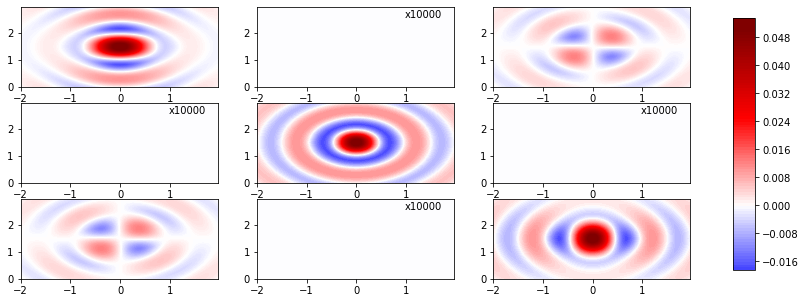

In [104]:
our_cmap = 'seismic'

fig, axs = plt.subplots(3, 3, figsize=(12,5))
cs00 = axs[0,0].contourf(x, z, G0xx_points1, 1000, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs01 = axs[0,1].contourf(x, z, G0yx_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs02 = axs[0,2].contourf(x, z, G0zx_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs10 = axs[1,0].contourf(x, z, G0xy_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs11 = axs[1,1].contourf(x, z, G0yy_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs12 = axs[1,2].contourf(x, z, G0zy_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs20 = axs[2,0].contourf(x, z, G0xz_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs21 = axs[2,1].contourf(x, z, G0yz_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs22 = axs[2,2].contourf(x, z, G0zz_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)

# fig.colorbar(cs00, ax=axs[0,0])
# fig.colorbar(cs01, ax=axs[0,1])
# fig.colorbar(cs02, ax=axs[0,2])
# fig.colorbar(cs10, ax=axs[1,0])
# fig.colorbar(cs11, ax=axs[1,1])
# fig.colorbar(cs12, ax=axs[1,2])
# fig.colorbar(cs20, ax=axs[2,0])
# fig.colorbar(cs21, ax=axs[2,1])
# fig.colorbar(cs22, ax=axs[2,2])

css = [cs00, cs01, cs02, cs10, cs11, cs12, cs20, cs21, cs22] 
css1000 = [(0,1), (1,0), (1,2), (2,1)]
for csij in css:
    for c in csij.collections:
        c.set_edgecolor("face")

for i,j in css1000: 
    axs[i,j].annotate('x10000', (0.75,0.86), xycoords='axes fraction')

fig.colorbar(cs22, cax=fig.add_axes([0.95, 0.15, 0.025, 0.7]))

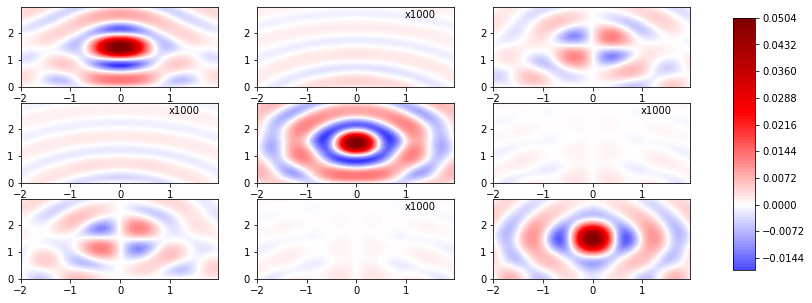

In [103]:
our_cmap = 'seismic'

fig, axs = plt.subplots(3, 3, figsize=(12,5))
cs00 = axs[0,0].contourf(x, z, Gxx_points1 + G0xx_points1, 1000, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs01 = axs[0,1].contourf(x, z, Gyx_points1*1000 + G0yx_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs02 = axs[0,2].contourf(x, z, Gzx_points1 + G0zx_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs10 = axs[1,0].contourf(x, z, Gxy_points1*1000 + G0xy_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs11 = axs[1,1].contourf(x, z, Gyy_points1 + G0yy_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs12 = axs[1,2].contourf(x, z, Gzy_points1*1000 + G0zy_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs20 = axs[2,0].contourf(x, z, Gxz_points1 + G0xz_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs21 = axs[2,1].contourf(x, z, Gyz_points1*1000 + G0yz_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)
cs22 = axs[2,2].contourf(x, z, Gzz_points1 + G0zz_points1, 100, vmin=-0.05, vmax=0.05, cmap=our_cmap)

# fig.colorbar(cs00, ax=axs[0,0])
# fig.colorbar(cs01, ax=axs[0,1])
# fig.colorbar(cs02, ax=axs[0,2])
# fig.colorbar(cs10, ax=axs[1,0])
# fig.colorbar(cs11, ax=axs[1,1])
# fig.colorbar(cs12, ax=axs[1,2])
# fig.colorbar(cs20, ax=axs[2,0])
# fig.colorbar(cs21, ax=axs[2,1])
# fig.colorbar(cs22, ax=axs[2,2])

css = [cs00, cs01, cs02, cs10, cs11, cs12, cs20, cs21, cs22] 
css1000 = [(0,1), (1,0), (1,2), (2,1)]
for csij in css:
    for c in csij.collections:
        c.set_edgecolor("face")

for i,j in css1000: 
    axs[i,j].annotate('x1000', (0.75,0.86), xycoords='axes fraction')

fig.colorbar(cs22, cax=fig.add_axes([0.95, 0.15, 0.025, 0.7]))